<a href="https://colab.research.google.com/github/evan4C/DeepLearning/blob/master/detectron2.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

安装detectron2依赖库：

- pytorch==1.5, 基本的机器学习库
- torchvision==0.6, 配合pytorch进行图像处理
- cpython, 借助于源代码编译器将Python代码转换为同等的C语言，提高代码运行速度
- pyyaml, 处理coco数据集中配置文件的库，不导入会在随后报错。
- pycocotools, 即python api tools of COCO。COCO是一个大型的图像数据集，用于目标检测、分割、人的关键点检测、素材分割和标题生成。这个包提供了Python的api有助于在COCO中加载、解析和可视化注释。

In [ ]:
!pip install -U torch==1.5 torchvision==0.6 -f https://download.pytorch.org/whl/cu101/torch_stable.html 
!pip install cython
!pip install -U 'git+https://github.com/cocodataset/cocoapi.git#subdirectory=PythonAPI'

Looking in links: https://download.pytorch.org/whl/cu101/torch_stable.html
Requirement already up-to-date: torch==1.5 in /usr/local/lib/python3.6/dist-packages (1.5.0+cu101)
Requirement already up-to-date: torchvision==0.6 in /usr/local/lib/python3.6/dist-packages (0.6.0+cu101)
  Cloning https://github.com/cocodataset/cocoapi.git to /tmp/pip-req-build-8_zhrqvn
  Running command git clone -q https://github.com/cocodataset/cocoapi.git /tmp/pip-req-build-8_zhrqvn
  Created wheel for pycocotools: filename=pycocotools-2.0-cp36-cp36m-linux_x86_64.whl size=266462 sha256=ba97b06c3f82fc20a359c9c99448d4184c6d4846eefc8c02e2024aff37a46703
  Stored in directory: /tmp/pip-ephem-wheel-cache-x54m4nns/wheels/90/51/41/646daf401c3bc408ff10de34ec76587a9b3ebfac8d21ca5c3a
Successfully built pycocotools
  Found existing installation: pycocotools 2.0
    Uninstalling pycocotools-2.0:
      Successfully uninstalled pycocotools-2.0


In [ ]:
import torch, torchvision
print(torch.__version__, torch.cuda.is_available())

1.5.0+cu101 True


In [ ]:
!pip install detectron2==0.1.3 -f https://dl.fbaipublicfiles.com/detectron2/wheels/cu101/torch1.5/index.html

Looking in links: https://dl.fbaipublicfiles.com/detectron2/wheels/cu101/torch1.5/index.html
     |████████████████████████████████| 6.2MB 4.4MB/s 
  Created wheel for fvcore: filename=fvcore-0.1.1.post20200716-cp36-none-any.whl size=42325 sha256=89089b7182afbe5c05859416658e1255b21edb6fc9458cf652b9f89fc3095ab8
  Stored in directory: /root/.cache/pip/wheels/81/99/f4/42a6bef61c07b3d78dfe6d7ebff259444c4526504cf72378d7
Successfully built fvcore
ERROR: fvcore 0.1.1.post20200716 has requirement pyyaml>=5.1, but you'll have pyyaml 3.13 which is incompatible.


In [ ]:
!pip install pyyaml==5.1

     |████████████████████████████████| 276kB 4.4MB/s 
  Created wheel for pyyaml: filename=PyYAML-5.1-cp36-cp36m-linux_x86_64.whl size=44075 sha256=24a1edf7ae85827e3936e2d5220daa790c83f9ba324e3a01d463d3ec21df7540
  Stored in directory: /root/.cache/pip/wheels/ad/56/bc/1522f864feb2a358ea6f1a92b4798d69ac783a28e80567a18b
Successfully built pyyaml
  Found existing installation: PyYAML 3.13
    Uninstalling PyYAML-3.13:
      Successfully uninstalled PyYAML-3.13


In [ ]:
# 加载一些基础包以及设置logger
import detectron2
from detectron2.utils.logger import setup_logger

setup_logger()

# 加载一些常用库
import numpy as np
import cv2
import random
from google.colab.patches import cv2_imshow

# 加载相关工具
from detectron2 import model_zoo
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog

In [ ]:
!ls

sample_data  test_img.jpg


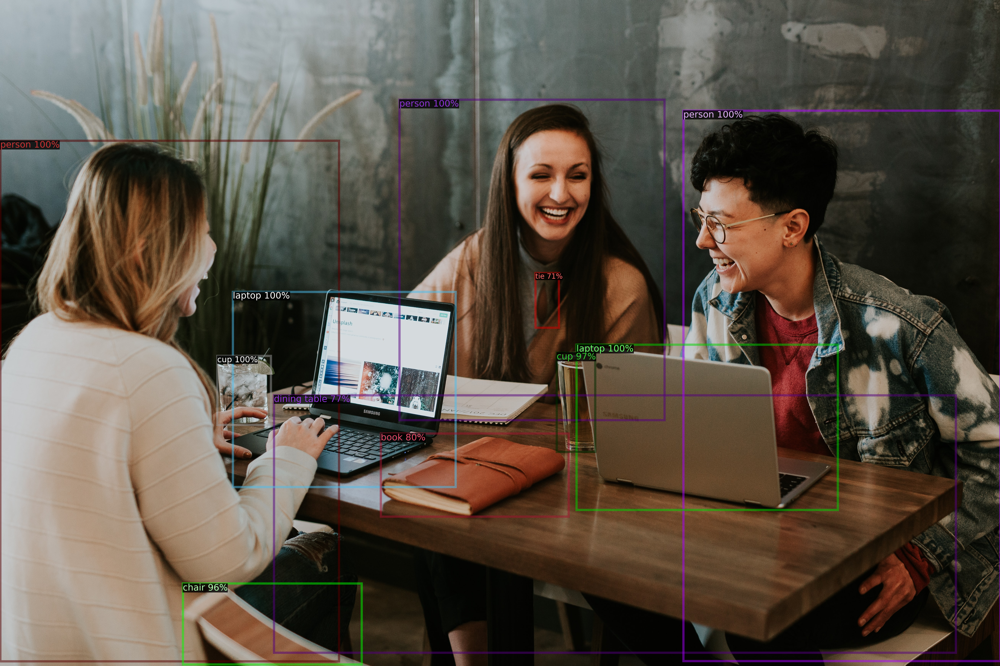

In [ ]:
input_path = "test_img.jpg"

# 指定模型的配置配置文件路径及网络参数文件的路径
# 对于像下面这样写法的网络参数文件路径，程序在运行的时候就自动寻找，如果没有则下载。
model_file_path = model_zoo.get_config_file("COCO-Detection/faster_rcnn_X_101_32x8d_FPN_3x.yaml")
model_weights = model_zoo.get_checkpoint_url("COCO-Detection/faster_rcnn_X_101_32x8d_FPN_3x.yaml")

# 加载图片
img = cv2.imread(input_path)

# 创建一个detectron2配置
cfg = get_cfg()
# 要创建的模型的名称
cfg.merge_from_file(model_file_path)
# 为模型设置阈值
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5
# 加载模型需要的数据
cfg.MODEL.WEIGHTS = model_weights
# 基于配置创建一个默认推断
predictor = DefaultPredictor(cfg)
# 利用这个推断对加载的影像进行分析并得到结果
outputs = predictor(img)

# 得到结果后可以使用Visualizer对结果可视化
# img[:, :, ::-1]表示将BGR波段顺序变成RGB
# scale表示输出影像的缩放尺度，太小了会导致看不清
v = Visualizer(img[:, :, ::-1], MetadataCatalog.get(cfg.DATASETS.TRAIN[0]), scale=0.8)
v = v.draw_instance_predictions(outputs["instances"].to("cpu"))
# 获得绘制的影像
result = v.get_image()[:, :, ::-1]
# 将影像保存到文件
cv2_imshow(result)